In [ ]:
import glob
from itertools import chain
import os
import random
import zipfile
from tqdm.notebook import tqdm

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from PIL import Image
from sklearn.model_selection import train_test_split
import cv2

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.optim.lr_scheduler import StepLR, CosineAnnealingLR, ReduceLROnPlateau
from torch.utils.data import DataLoader, Dataset
from torchvision import datasets, transforms, models
import librosa
import requests
import shutil

Contenido: Notebook que tiene la ejecución del modelo con el dataset completo (sin aplicar spleeter)
Dataset: Dataset sin spleeter. Audios solo cortados en 30 sec. 

In [ ]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [ ]:
path_full_data = '/content/drive/Shared drives/SpotifyMemoria/MM_full/Full_data/audio/'

In [ ]:
dataset_df = pd.DataFrame(columns=['Partición', 'Género', 'Cantidad'])
dataset_df

,Partición,Género,Cantidad


In [ ]:
path = '/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/'

spotify_ids = []
genres = []
splits = ['val', 'test', 'train']

cont = 0


for s in splits:
  total_split = 0
  curr_path = audio_path.replace("train",s)
  for folder in os.listdir(curr_path):
    genre = folder
    audio_path_file = curr_path + folder 
    audio_files = os.listdir(audio_path_file)
    print(folder)
    print(len(audio_files))
    print("------------------")
    cont = cont + len(audio_files)
    total_split+=len(audio_files)
    #dataset_df = dataset_df.append({'Partición': s, 'Género': folder, 'Cantidad': len(audio_files)}, ignore_index=True)
  print("--------------------------------------------------------")
  print(s+str(total_split))

print(cont)


NameError: ignored

In [ ]:
genres_y = [ 'blues', 'bluegrass', 'death-metal','ambient', 'alt-rock', 'afrobeat', 'acoustic', 'club', 'chill', 'deep-house', 'alternative', 'black-metal', 'breakbeat', 'british', 'cantopop', 'disco', 'edm']

In [ ]:
images_full = '/content/drive/Shared drives/SpotifyMemoria/Cover_art_dataset/'

#Path de train

audio_path = '/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/train/audio/'
image_path =  '/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/train/image/'
spect_path = '/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/train/audio_spectrogram/'

In [ ]:
#Path de test

audio_test = '/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/test/audio/'
image_test = '/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/test/image/'
spect_test = '/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/test/audio_spectrogram/'


In [ ]:
#Path de val

audio_val = '/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/val/audio/'
image_val = '/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/val/image/'
spect_val = '/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/val/audio_spectrogram/'

In [ ]:
PATH_TRAIN = '/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/train/'
PATH_VALID = '/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/val/'

### Extraer espectrogramas de cada audio del dataset

In [ ]:
#Extract spectrogram from every audio
'''
audio_path_2 = '/content/drive/Shared drives/SpotifyMemoria/MM_full/train/audio/'
spect_path_2 =  '/content/drive/Shared drives/SpotifyMemoria/MM_full/train/audio_spectrogram/'

cmap = plt.get_cmap('inferno')
plt.figure(figsize=(8,8))
#genres = 'blues classical country disco hiphop jazz metal pop reggae rock'.split()
genres = os.listdir(audio_path_2)
for g in genres:
    a_path= g 
    songs = os.listdir(audio_path_2+a_path)
    if not os.path.exists(spect_path_2+g):
  
        # Create a new directory because it does not exist 
        os.makedirs(spect_path_2+g)
    for j in songs:

        spotify_id = j.split('.')[0]
        spect_file = spotify_id + '.jpg'
        if os.path.exists(spect_path_2+g+'/'+spect_file):
          continue

        y, sr = librosa.load(audio_path_2+g+'/'+j, mono=True, duration=5)
        plt.specgram(y, NFFT=2048, Fs=2, Fc=0, noverlap=128, cmap=cmap, sides='default', mode='default', scale='dB');
        plt.axis('off');
        print(spect_path_2+g+'/'+spect_file)
        plt.savefig(spect_path_2+g+'/'+spect_file)
        plt.clf()

### Guardar imágenes de cada audio del dataset

In [ ]:
'''
def req_cover_img(img_url,file_ruta):
    response = requests.get(img_url)
    print(response.status_code)
    #file_ruta = base_url + row['genre'] + '/' + row['id_spotify']+".jpg"
    print(file_ruta)
    file = open(file_ruta,"wb+")
    file.write(response.content)
    file.close()

In [ ]:
'''
genres = os.listdir(audio_path_2)
for g in genres:
     os.makedirs(image_path_2+g)

In [ ]:
drive_path = '/content/drive/Shared drives/SpotifyMemoria/'
image_path_2 = '/content/drive/Shared drives/SpotifyMemoria/MM_full/train/image/'

In [ ]:
 '''
 #agregar cover art faltante 
genres = os.listdir(audio_path_2)

for i in genres:
    a_path= i 
    songs = os.listdir(audio_path_2+a_path)
    for j in songs:
      spotify_id = j.split('.')[0]
      image_file = spotify_id + '.jpg'

      if(not os.path.exists(image_path_2 + i + '/' + image_file)):
        print("Este tema no tiene cover art")
        spotify = pd.read_csv(drive_path+'spotify_dataset.csv')

        print((spotify.loc[spotify['id_spotify'] == spotify_id]).columns)
        image_url = spotify.loc[spotify['id_spotify'] == spotify_id,'image_url'].values[0]
        print('url', image_url)

        req_cover_img(image_url, image_path_2+i+'/'+image_file)
        continue
      else:
        print(spotify_id)

### Split dataset into train and test

In [ ]:
!pip install split-folders

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
#Split de prueba
import splitfolders

path_destino = '/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/'

In [ ]:
path_fuente = "/content/drive/Shared drives/SpotifyMemoria/MM_full/Full_data/audio/"

In [ ]:
#splitfolders.ratio(path_fuente, output=path_destino, seed=1337, ratio=(.7, 0.15,0.15)) 

Copying files: 18684 files [08:43, 35.67 files/s]


In [ ]:
#Mover imagenes a su carpeta
'''
path_fuente_image = "/content/drive/Shared drives/SpotifyMemoria/MM_full/Full_data/image/"

genre = os.listdir(path_fuente_image)

cont_train = 0
cont_val = 0
cont_test = 0

for g in genre: 
  covers = os.listdir(path_fuente_image+g)
  for c in covers:
    audio = c.replace('.jpg', '.mp3')
    print(audio)
    #agregarle el .mp3
    if os.path.exists(audio_path+g+'/'+audio):
      if not os.path.exists(image_path+g):
        os.makedirs(image_path+g)

      origen = path_fuente_image+g+'/'+c
      destino = image_path+g+'/'+c
      shutil.move(origen, destino)
      cont_train+=1
    
    elif os.path.exists(audio_test+g+'/'+audio):  
      if not os.path.exists(image_test+g):
        os.makedirs(image_test+g)

      origen = path_fuente_image+g+'/'+c
      destino = image_test+g+'/'+c
      shutil.move(origen, destino)
      cont_test+=1

    elif os.path.exists(audio_val+g+'/'+audio):
      if not os.path.exists(image_val+g):
        os.makedirs(image_val+g)

      origen = path_fuente_image+g+'/'+c
      destino = image_val+g+'/'+c
      shutil.move(origen, destino)
      cont_val+=1

    else:
      continue

    print('origen',origen)
    print('destino',destino)
print('train',cont_train)
print('val',cont_val)
print('test',cont_test)
    #Crear directorio con genero y mover la imagen a su carpeta correspondiente


'''

train 0
val 0
test 0


In [ ]:
#Mover spectrogramas a su carpeta

'''

path_fuente_spect = "/content/drive/Shared drives/SpotifyMemoria/MM_full/Full_data/audio_spectrogram/"

genre = os.listdir(path_fuente_spect)

cont_train = 0
cont_val = 0
cont_test = 0

for g in genre: 
  covers = os.listdir(path_fuente_spect+g)
  for c in covers:
    audio = c.replace('.jpg', '.mp3')
    print(audio)
    #agregarle el .mp3
    if os.path.exists(audio_path+g+'/'+audio):
      if not os.path.exists(spect_path+g):
        os.makedirs(spect_path+g)

      origen = path_fuente_spect+g+'/'+c
      destino = spect_path+g+'/'+c
      shutil.move(origen, destino)
      cont_train+=1
    
    elif os.path.exists(audio_test+g+'/'+audio):  
      if not os.path.exists(spect_test+g):
        os.makedirs(spect_test+g)

      origen = path_fuente_spect+g+'/'+c
      destino = spect_test+g+'/'+c
      shutil.move(origen, destino)
      cont_test+=1

    elif os.path.exists(audio_val+g+'/'+audio):
      if not os.path.exists(spect_val+g):
        os.makedirs(spect_val+g)

      origen = path_fuente_spect+g+'/'+c
      destino = spect_val+g+'/'+c
      shutil.move(origen, destino)
      cont_val+=1

    else:
      continue

    print('origen',origen)
    print('destino',destino)
print('train',cont_train)
print('val',cont_val)
print('test',cont_test)

    #Crear directorio con genero y mover el spectrograma a su carpeta correspondiente


'''

## Modelo

In [ ]:
class TripletData(Dataset):
    def __init__(self, path, transforms, split="train"):
        self.path = '/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/'
        self.split = split    # train or valid
        self.cats = 10       # number of categories
        self.transforms = transforms
        self.genres_y = [ 'blues', 'bluegrass', 'death-metal','ambient', 'alt-rock', 'afrobeat', 'acoustic', 'club', 'chill', 'deep-house']
        self.spect_path = '/audio_spectrogram/'
        self.image_path = '/image/'
    
    def __getitem__(self, idx):
        
        # our positive class for the triplet
        #idx = str(idx%self.cats + 1)
        idx = self.genres_y[idx%self.cats - 1]

        # choosing our pair of positive images (im1, im2)
        positives = os.listdir(self.path+self.split+self.spect_path+idx)
        #im1, im2 = random.sample(positives, 2)
        im1_id = random.choice(positives)
        im2_id = (im1_id.split('.')[0]) + '.jpg'


        while (not os.path.exists(self.path+self.split+self.image_path+idx+'/'+im2_id)): 
          im1_id = random.choice(positives)
          im2_id = (im1_id.split('.')[0]) + '.jpg'

        # choosing a negative class and negative image (im3)
        #negative_cats = [str(x+1) for x in range(self.cats)]
        #negative_cats.remove(idx)
        negative_cats = [x for x in genres_y if x != idx]
        negative_cat = str(random.choice(negative_cats))

        #negatives = os.listdir(os.path.join(self.path, negative_cat))
        negatives = os.listdir(self.path+self.split+self.image_path+negative_cat)
        im3_id = random.choice(negatives)
        
        im1 = Image.open(self.path+self.split+self.spect_path+idx+'/'+im1_id)
        im2 = Image.open(self.path+self.split+self.image_path+idx+'/'+im2_id)
        im3 = Image.open(self.path+self.split+self.image_path+negative_cat+'/'+im3_id)

        if(im1.mode == 'L'):
          print(self.path+self.split+self.spect_path+idx+'/'+im1_id)
          im1 = im1.convert('RGB')

        elif(im2.mode == 'L'):
          print(self.path+self.split+self.image_path+idx+'/'+im2_id)
          im2 = im2.convert('RGB')
        
        elif(im3.mode == 'L'):
          print(self.path+self.split+self.image_path+negative_cat+'/'+im3_id)
          im3 = im3.convert('RGB')


        im1 = self.transforms(im1)
        im2 = self.transforms(im2)
        im3 = self.transforms(im3)
        
        #print('perrito')

        return [im1, im2, im3]
        
    # we'll put some value that we want since there can be far too many triplets possible
    # multiples of the number of images/ number of categories is a good choice
    def __len__(self):
        return self.cats*8
    

# Transforms
train_transforms = transforms.Compose([
    transforms.Resize((224,224)),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
])

val_transforms = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
])


# Datasets and Dataloaders
train_data = TripletData(PATH_TRAIN, train_transforms)
val_data = TripletData(PATH_VALID, val_transforms)

train_loader = torch.utils.data.DataLoader(dataset = train_data, batch_size=32, shuffle=True, num_workers=2)
val_loader = torch.utils.data.DataLoader(dataset = val_data, batch_size=32, shuffle=False, num_workers=2)

In [ ]:
class TripletLoss(nn.Module):
    def __init__(self, margin=1.0):
        super(TripletLoss, self).__init__()
        self.margin = margin
        
    def calc_euclidean(self, x1, x2):
        return (x1 - x2).pow(2).sum(1)
    
    # Distances in embedding space is calculated in euclidean
    def forward(self, anchor, positive, negative):
        distance_positive = self.calc_euclidean(anchor, positive)
        distance_negative = self.calc_euclidean(anchor, negative)
        losses = torch.relu(distance_positive - distance_negative + self.margin)
        return losses.mean()

In [ ]:
#https://towardsdatascience.com/a-hands-on-introduction-to-image-retrieval-in-deep-learning-with-pytorch-651cd6dba61e
epochs = 15
device = 'cuda'

# Our base model
model = models.resnet18().cuda()
optimizer = optim.Adam(model.parameters(), lr=0.001)
triplet_loss = TripletLoss()

# Training
for epoch in range(epochs):
    
    model.train()
    epoch_loss = 0.0
    for data in tqdm(train_loader):
        optimizer.zero_grad()
        x1,x2,x3 = data
        e1 = model(x1.to(device))
        e2 = model(x2.to(device))
        e3 = model(x3.to(device)) 
        
        loss = triplet_loss(e1,e2,e3)
        epoch_loss += loss
        loss.backward()
        optimizer.step()
    print("Train Loss: {}".format(epoch_loss.item()))

  0%|          | 0/3 [00:00<?, ?it/s]

/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/train/image/death-metal/3rHuhOKNZr91fXM9HHbdNb.jpg
/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/train/image/club/7rGmOXB4xH2A5jEK0gKD3N.jpg
/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/train/image/black-metal/1twTdzxZPY1SU5vueG7v6U.jpg
Train Loss: 55.9759521484375


  0%|          | 0/3 [00:00<?, ?it/s]

Train Loss: 54.166385650634766


  0%|          | 0/3 [00:00<?, ?it/s]

/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/train/image/chill/3qbOROR75LnNeWw8SvZL24.jpg
Train Loss: 63.259971618652344


  0%|          | 0/3 [00:00<?, ?it/s]

/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/train/image/club/3MFBFXmISHQdhEN3AFFuOs.jpg
/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/train/image/breakbeat/3sOEDTRQ6SQopwnVUtNYp1.jpg
/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/train/image/ambient/35VfLKymw2iZKWnLTvm8Xv.jpg
Train Loss: 30.426254272460938


  0%|          | 0/3 [00:00<?, ?it/s]

/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/train/image/edm/6J5Oxg5XtxRdVAbExaWFYB.jpg
/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/train/image/alt-rock/1XTGyfJeMiZXrZ1W3NolcB.jpg
/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/train/image/edm/5AI3AO39mQi7oJsgA9DRu8.jpg
/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/train/image/black-metal/3RfJSzHkZl0ZGhu8B0LpEV.jpg
/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/train/image/acoustic/0X9MxHR1rTkEHDjp95F2OO.jpg
Train Loss: 19.80489730834961


  0%|          | 0/3 [00:00<?, ?it/s]

/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/train/image/ambient/7pAksEVGKqiXRvl2bO0vhy.jpg
Train Loss: 14.147538185119629


  0%|          | 0/3 [00:00<?, ?it/s]

/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/train/image/blues/1INksmStBpxdNlBzwGUvsg.jpg
Train Loss: 12.078577041625977


  0%|          | 0/3 [00:00<?, ?it/s]

/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/train/image/black-metal/2Q9ioktLG7vwS7TG5qJNuM.jpg
/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/train/image/ambient/7pAksEVGKqiXRvl2bO0vhy.jpg
/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/train/image/chill/3qbOROR75LnNeWw8SvZL24.jpg
Train Loss: 9.190319061279297


  0%|          | 0/3 [00:00<?, ?it/s]

/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/train/image/death-metal/2JIRtFAIUkd86PQD12Hm7r.jpg
/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/train/image/bluegrass/6m6KpVOQysuNz2kDTo027y.jpg
/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/train/image/acoustic/40kxsbln77BpIcTtEUCVQF.jpg
/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/train/image/chill/7IITbM93TjfDQYP7wT6E9G.jpg
/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/train/image/blues/3omXshBamrREltcf24gYDC.jpg
Train Loss: 8.907137870788574


  0%|          | 0/3 [00:00<?, ?it/s]

Train Loss: 8.256021499633789


  0%|          | 0/3 [00:00<?, ?it/s]

/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/train/image/breakbeat/1tG5Tdihl13aTLNZHoIbJJ.jpg
Train Loss: 6.411337375640869


  0%|          | 0/3 [00:00<?, ?it/s]

/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/train/image/british/7oOEFDLSQscl0uGulnIEmG.jpg
Train Loss: 4.405925750732422


  0%|          | 0/3 [00:00<?, ?it/s]

Train Loss: 3.533750534057617


  0%|          | 0/3 [00:00<?, ?it/s]

/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/train/image/british/7fex2V7RzWl9nCKyILjibB.jpg
Train Loss: 3.9755711555480957


  0%|          | 0/3 [00:00<?, ?it/s]

/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/train/image/bluegrass/0rU4PW612tgLpBfuEfgEF4.jpg
Train Loss: 3.757963180541992


In [ ]:
!pip install faiss-gpu

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 85.5 MB 123 kB/s 


In [ ]:
#!pip install faiss-gpu
import faiss                            
faiss_index = faiss.IndexFlatL2(1000)   # build the index

im_indices = []
with torch.no_grad():
    for genre in genres_y: 
        path_curr = PATH_TRAIN+ 'audio_spectrogram/' + genre
        search_path = os.listdir(path_curr)
    #for f in glob.glob(os.path.join(PATH_TRAIN, '*/*')):
        for f in search_path:
          im = Image.open(path_curr+'/'+f)
          if(im.mode == 'RGBA'):
            print(path_curr+'/'+f)
          im = im.resize((224,224))
          im = torch.tensor([val_transforms(im).numpy()]).cuda()
      
          preds = model(im)
          preds = np.array([preds[0].cpu().numpy()])
          faiss_index.add(preds) #add the representation to index
          im_indices.append(f)   #store the image name to find it later on

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:16: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at  ../torch/csrc/utils/tensor_new.cpp:201.)
  app.launch_new_instance()


In [ ]:
PATH_TEST = '/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/test/'

In [ ]:
from sys import path
with torch.no_grad():
    for genre in genres_y: 
        path_curr = PATH_TEST+ 'audio_spectrogram/' + genre
        search_path = os.listdir(path_curr)
    #for f in glob.glob(os.path.join(PATH_TRAIN, '*/*')):
        for f in search_path:
          im = Image.open(os.path.join(path_curr,f))
          im = im.resize((224,224))
          im = torch.tensor([val_transforms(im).numpy()]).cuda()
      
          test_embed = model(im).cpu().numpy()
          _, I = faiss_index.search(test_embed, 5)
          #print("Retrieved Image: {}".format(im_indices[I[0][0]]))

In [ ]:
len(im_indices)

### Prueba retrieval

In [ ]:
prueba =  'black-metal/0ASlBt3KdsnokRI137AbUl'

In [ ]:
#Pista musical
import IPython.display as ipd
ipd.Audio(audio_test+prueba+'.mp3')
#playsound(audio_path+'death-metal/0cEai6VAETowu2cm83Gt8l.wav')

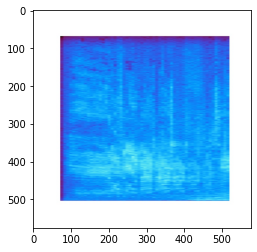

In [ ]:
#Espectrograma
import numpy as np
import cv2
import matplotlib.pyplot as plt
%matplotlib inline 

img = cv2.imread(spect_test+prueba+'.jpg',1) # reads image 'opencv-logo.png' as grayscale
plt.imshow(img)

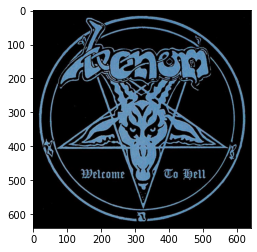

In [ ]:
#Imagen cover art
img = cv2.imread(image_test+prueba+'.jpg',1) # reads image 'opencv-logo.png' as grayscale
plt.imshow(img)

In [ ]:
#Top 100 k nearest neighbour, I used 6000 for GAN tuning test
def get_kNN(path_image):
  with torch.no_grad():
    n_knn = 800
    im = Image.open(path_image)
    im = im.resize((224,224))
    im = torch.tensor([val_transforms(im).numpy()]).cuda()

    test_embed = model(im).cpu().numpy()
    _, I = faiss_index.search(test_embed, n_knn) #Tensor de la imagen y la cantidad de kNN
    #print("Retrieved Image: {}".format(im_indices[I[0][0]]))
    return I  #Contiene los indices de los 10 vecinos más cercanos

In [ ]:
kNN = get_kNN(spect_test+prueba+'.jpg')

In [ ]:
len(kNN[0])

800

In [ ]:
def search_path(file, path):

  files = glob.glob(path + "/**/"+file, recursive = True)

  #print(files)
  return files[0]

In [ ]:
def show_knn(knn, path):
  n_knn = 800
  knn_list = []
  files_list = []
  for i in range(n_knn):  
    #print(knn[0][i-1])
    image = im_indices[knn[0][i-1]]
    #print(image)
    files = search_path(image, path)
    #print(files)
    files_list.append(files)
    knn_list.append(image)
  return knn_list, files_list

In [ ]:
image_test

'/content/drive/Shared drives/SpotifyMemoria/MM_full/splits/test/image/'

In [ ]:
knn_list, files_list = show_knn(kNN, image_path)

KeyboardInterrupt: ignored

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline

def plot_knn(files_list):
  images = []
  for img_path in files_list:
      images.append(mpimg.imread(img_path))

  plt.figure(figsize=(40,40))
  f, axarr = plt.subplots(2,5)

  axarr[0,0].imshow(images[0])
  axarr[0,1].imshow(images[1])
  axarr[0,2].imshow(images[2])
  axarr[0,3].imshow(images[3])
  axarr[0,4].imshow(images[4])
  axarr[1,0].imshow(images[5])
  axarr[1,1].imshow(images[6])
  axarr[1,2].imshow(images[7])
  axarr[1,3].imshow(images[8])
  axarr[1,4].imshow(images[9])

In [ ]:
from PIL import Image
cont = 0
for img_path in files_list:
    img  = mpimg.imread(img_path)
    im = Image.fromarray(img)
    im.save('/content/drive/Shared drives/SpotifyMemoria/MM_full/knn/'+str(cont)+'.jpg')
    cont+=1




<Figure size 2880x2880 with 0 Axes>

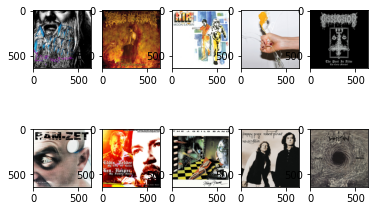

In [ ]:
plot_knn(files_list)

## GAN COVER ART GENERATION

In [ ]:
#Train GAN to generate images from the k nearest neighbours

import tensorflow as tf
from tensorflow.keras.layers import (Dense, 
                                     BatchNormalization, 
                                     LeakyReLU, 
                                     Reshape, 
                                     Conv2DTranspose,
                                     Conv2D,
                                     Dropout,
                                     Flatten)
import matplotlib.pyplot as plt

In [ ]:
# load image and convert to and from NumPy array
from PIL import Image
from numpy import asarray
from skimage import transform, data, io
import cv2
# load the image
def img_to_array(path):

  img = cv2.imread(path, 1) #change 1 to 0 for gray images

  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  img = cv2.resize(img, (128,128))
  # convert image to numpy array
  #image = image.convert('RGB')
  data = asarray(img)
  #data = tf.convert_to_tensor(data)
  # summarize shape
  return data

In [ ]:
#Load data version 100 images, aqui podria cambiar por las 6000 a ver q pasa
train_images = np.zeros((100, 256,256,3))
for index, file in enumerate(files_list):
  image = img_to_array(file)
  train_images[index] = image

BUFFER_SIZE = 100
BATCH_SIZE = 10

# Batch and shuffle the data
train_dataset = tf.data.Dataset.from_tensor_slices(train_images).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

ValueError: ignored

In [ ]:
#Discriminador
'''
def make_generator_model():
    model = tf.keras.Sequential()
    model.add(Dense(7*7*256, use_bias=False, input_shape=(100,)))
    model.add(BatchNormalization())
    model.add(LeakyReLU())

    model.add(Reshape((7, 7, 256)))
    assert model.output_shape == (None, 7, 7, 256) # Note: None is the batch size

    model.add(Conv2DTranspose(128, (5, 5), strides=(1, 1), padding='same', use_bias=False))
    assert model.output_shape == (None, 7, 7, 128)
    model.add(BatchNormalization())
    model.add(LeakyReLU())

    model.add(Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    assert model.output_shape == (None, 14, 14, 64)
    model.add(BatchNormalization())
    model.add(LeakyReLU())

    model.add(Conv2DTranspose(1, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
    assert model.output_shape == (None, 28, 28, 1)

    return model

    '''

In [ ]:
def make_generator_model():
    model = tf.keras.Sequential()
    model.add(Dense(64*64*256, use_bias=False, input_shape=(100,)))
    model.add(BatchNormalization())
    model.add(LeakyReLU())

    model.add(Reshape((64, 64, 256)))
    print(model.output_shape)
    assert model.output_shape == (None, 64, 64, 256) # Note: None is the batch size

    model.add(Conv2DTranspose(128, (5, 5), strides=(1, 1), padding='same', use_bias=False))
    assert model.output_shape == (None, 64, 64, 128)
    model.add(BatchNormalization())
    model.add(LeakyReLU())

    model.add(Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    assert model.output_shape == (None, 128, 128, 64)
    model.add(BatchNormalization())
    model.add(LeakyReLU())

    model.add(Conv2DTranspose(3, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
    assert model.output_shape == (None, 256, 256, 3)

    return model

In [ ]:
generator = make_generator_model()

(None, 64, 64, 256)


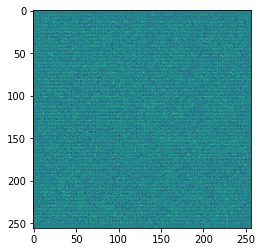

In [ ]:
#Generar random noise
# Create a random noise and generate a sample

#imarray = numpy.random.rand(100,100,3) * 255
#im = Image.fromarray(imarray.astype('uint8')).convert('RGBA')
noise = tf.random.normal([BATCH_SIZE, 100])
plt.imshow(noise)
generated_image = generator(noise, training=False)
# Visualize the generated sample
plt.imshow(generated_image[0, :, :, 0])

In [ ]:
#Se crea el Discriminador 
def make_discriminator_model():
    model = tf.keras.Sequential()
    
    model.add(Conv2D(64, (5, 5), strides=(2, 2), padding='same', input_shape=[256, 256, 3]))
    model.add(LeakyReLU())
    model.add(Dropout(0.3))

    model.add(Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(LeakyReLU())
    model.add(Dropout(0.3))

    model.add(Flatten())
    model.add(Dense(1))

    return model

In [ ]:
discriminator = make_discriminator_model()

In [ ]:
decision = discriminator(generated_image)
print (decision)

tf.Tensor(
[[0.00059083]
 [0.00104699]
 [0.00100319]
 [0.0011974 ]
 [0.00091842]
 [0.00048551]
 [0.00042631]
 [0.00114344]
 [0.00112461]
 [0.00063452]], shape=(10, 1), dtype=float32)


In [ ]:
# This method returns a helper function to compute cross entropy loss
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

In [ ]:
import os

checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

In [ ]:
EPOCHS = 200
# We will reuse this seed overtime (so it's easier)
# to visualize progress in the animated GIF)
num_examples_to_generate = 16
noise_dim = 100
seed = tf.random.normal([num_examples_to_generate, noise_dim])

In [ ]:
# tf.function annotation causes the function 
# to be "compiled" as part of the training
@tf.function
def train_step(images):
  
    # 1 - Create a random noise to feed it into the model
    # for the image generation
    noise = tf.random.normal([BATCH_SIZE, noise_dim])
    
    # 2 - Generate images and calculate loss values
    # GradientTape method records operations for automatic differentiation.
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
      generated_images = generator(noise, training=True)

      real_output = discriminator(images, training=True)
      fake_output = discriminator(generated_images, training=True)

      gen_loss = generator_loss(fake_output)
      disc_loss = discriminator_loss(real_output, fake_output)

    # 3 - Calculate gradients using loss values and model variables
    # "gradient" method computes the gradient using 
    # operations recorded in context of this tape (gen_tape and disc_tape).
    
    # It accepts a target (e.g., gen_loss) variable and 
    # a source variable (e.g.,generator.trainable_variables)
    # target --> a list or nested structure of Tensors or Variables to be differentiated.
    # source --> a list or nested structure of Tensors or Variables.
    # target will be differentiated against elements in sources.

    # "gradient" method returns a list or nested structure of Tensors  
    # (or IndexedSlices, or None), one for each element in sources. 
    # Returned structure is the same as the structure of sources.
    gradients_of_generator = gen_tape.gradient(gen_loss, 
                                               generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, 
                                                discriminator.trainable_variables)
    
    # 4 - Process  Gradients and Run the Optimizer
    # "apply_gradients" method processes aggregated gradients. 
    # ex: optimizer.apply_gradients(zip(grads, vars))
    """
    Example use of apply_gradients:
    grads = tape.gradient(loss, vars)
    grads = tf.distribute.get_replica_context().all_reduce('sum', grads)
    # Processing aggregated gradients.
    optimizer.apply_gradients(zip(grads, vars), experimental_aggregate_gradients=False)
    """
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

In [ ]:
def generate_and_save_images(model, epoch, test_input):
  # Notice `training` is set to False.
  # This is so all layers run in inference mode (batchnorm).
  # 1 - Generate images
  predictions = model(test_input, training=False)
  # 2 - Plot the generated images
  fig = plt.figure(figsize=(4,4))
  for i in range(predictions.shape[0]):
      plt.subplot(4, 4, i+1)
      plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5)
      plt.axis('off')
  # 3 - Save the generated images
  plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
  plt.show()

In [ ]:
import time
from IPython import display # A command shell for interactive computing in Python.

def train(dataset, epochs):
  # A. For each epoch, do the following:
  for epoch in range(epochs):
    start = time.time()
    # 1 - For each batch of the epoch, 
    for image_batch in dataset:
      # 1.a - run the custom "train_step" function
      # we just declared above
      train_step(image_batch)

    # 2 - Produce images for the GIF as we go
    display.clear_output(wait=True)
    generate_and_save_images(generator,
                             epoch + 1,
                             seed)

    # 3 - Save the model every 5 epochs as 
    # a checkpoint, which we will use later
    if (epoch + 1) % 5 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    # 4 - Print out the completed epoch no. and the time spent
    print ('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

  # B. Generate a final image after the training is completed
  display.clear_output(wait=True)
  generate_and_save_images(generator,
                           epochs,
                           seed)

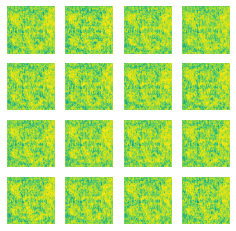

In [ ]:
train(train_dataset, EPOCHS)

In [ ]:
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

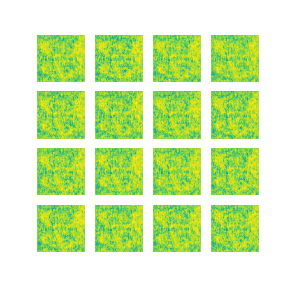

In [ ]:
# PIL is a library which may open different image file formats
import PIL 
# Display a single image using the epoch number
def display_image(epoch_no):
  return PIL.Image.open('image_at_epoch_{:04d}.png'.format(epoch_no))
display_image(EPOCHS)

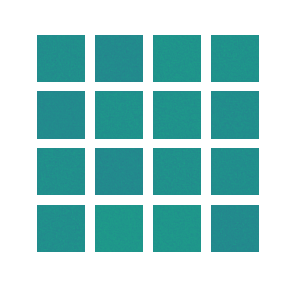

In [ ]:
import glob # The glob module is used for Unix style pathname pattern expansion.
import imageio # The library that provides an easy interface to read and write a wide range of image data

anim_file = 'dcgan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  # image = imageio.imread(filename)
  # writer.append_data(image)
  
display.Image(open('dcgan.gif','rb').read())

## GAN para generación de rostros

In [ ]:
from tqdm import tqdm
import numpy as np
import pandas as pd
import os
from matplotlib import pyplot as plt

#Load data version 100 images
train_images = np.zeros((100, 128,128,3))
for index, file in enumerate(files_list):
  image = img_to_array(file)
  train_images[index] = image

BUFFER_SIZE = 100
BATCH_SIZE = 10
HEIGHT = 128
WIDTH = 128

# Batch and shuffle the data
#images = tf.data.Dataset.from_tensor_slices(train_images).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

NameError: ignored

In [ ]:
import tensorflow as tf

In [ ]:

from tensorflow.keras.layers import Input
from tensorflow.keras import Model
from tensorflow.keras.optimizers import RMSprop

In [ ]:
LATENT_DIM = 32
CHANNELS = 3
def create_generator():
    gen_input = Input(shape=(LATENT_DIM, ))
    
    x = Dense(128 * 16 * 16)(gen_input)
    x = LeakyReLU()(x)
    x = Reshape((16, 16, 128))(x)
    
    x = Conv2D(256, 5, padding='same')(x)
    x = LeakyReLU()(x)
    
    x = Conv2DTranspose(256, 4, strides=2, padding='same')(x)
    x = LeakyReLU()(x)
    
    x = Conv2DTranspose(256, 4, strides=2, padding='same')(x)
    x = LeakyReLU()(x)
    
    x = Conv2DTranspose(256, 4, strides=2, padding='same')(x)
    x = LeakyReLU()(x)
    
    x = Conv2D(512, 5, padding='same')(x)
    x = LeakyReLU()(x)
    x = Conv2D(512, 5, padding='same')(x)
    x = LeakyReLU()(x)
    x = Conv2D(CHANNELS, 7, activation='tanh', padding='same')(x)
    
    generator = Model(gen_input, x)
    return generator

In [ ]:
def create_discriminator():
    disc_input = Input(shape=(HEIGHT, WIDTH, CHANNELS))
    
    x = Conv2D(256, 3)(disc_input)
    x = LeakyReLU()(x)
    
    x = Conv2D(256, 4, strides=2)(x)
    x = LeakyReLU()(x)
    
    x = Conv2D(256, 4, strides=2)(x)
    x = LeakyReLU()(x)
    
    x = Conv2D(256, 4, strides=2)(x)
    x = LeakyReLU()(x)
    
    x = Conv2D(256, 4, strides=2)(x)
    x = LeakyReLU()(x)
    
    x = Flatten()(x)
    x = Dropout(0.4)(x)
    
    x = Dense(1, activation='sigmoid')(x)
    discriminator = Model(disc_input, x)
    
    optimizer = RMSprop(
        lr=.0001,
        clipvalue=1.0,
        decay=1e-8
    )
    
    discriminator.compile(
        optimizer=optimizer,
        loss='binary_crossentropy'
    )
    
    return discriminator

In [ ]:
generator = create_generator()
discriminator = create_discriminator()
discriminator.trainable = False
gan_input = Input(shape=(LATENT_DIM, ))
gan_output = discriminator(generator(gan_input))
gan = Model(gan_input, gan_output)#Adversarial Model
optimizer = RMSprop(lr=.0001, clipvalue=1.0, decay=1e-8)
gan.compile(optimizer=optimizer, loss='binary_crossentropy')

/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/rmsprop.py:130: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(RMSprop, self).__init__(name, **kwargs)


In [ ]:
discriminator.trainable = False
import time
iters = 20000
batch_size = 16
RES_DIR = 'res2'
FILE_PATH = '%s/generated_1_%d.png'
if not os.path.isdir(RES_DIR):
    os.mkdir(RES_DIR)
CONTROL_SIZE_SQRT = 6
control_vectors = np.random.normal(size=(CONTROL_SIZE_SQRT**2, LATENT_DIM)) / 2
start = 0
d_losses = []
a_losses = []
images_saved = 0
for step in range(iters):
    start_time = time.time()
    latent_vectors = np.random.normal(size=(batch_size, LATENT_DIM))
    generated = generator.predict(latent_vectors)
    
    real = train_images[start:start + batch_size]
    combined_images = np.concatenate([generated, real])
    
    labels = np.concatenate([np.ones((batch_size, 1)), np.zeros((batch_size, 1))])
    labels += .05 * np.random.random(labels.shape)
    
    d_loss = discriminator.train_on_batch(combined_images, labels)
    d_losses.append(d_loss)
    
    latent_vectors = np.random.normal(size=(batch_size, LATENT_DIM))
    misleading_targets = np.zeros((batch_size, 1))
    
    a_loss = gan.train_on_batch(latent_vectors, misleading_targets)
    a_losses.append(a_loss)
    
    start += batch_size
    if start > train_images.shape[0] - batch_size:
        start = 0
    
    if step % 50 == 49:
        gan.save_weights('gan.h5')
        
        print('%d/%d: d_loss: %.4f,  a_loss: %.4f.  (%.1f sec)' % (step + 1, iters, d_loss, a_loss, time.time() - start_time))
        
        control_image = np.zeros((WIDTH * CONTROL_SIZE_SQRT, HEIGHT * CONTROL_SIZE_SQRT, CHANNELS))
        control_generated = generator.predict(control_vectors)
        for i in range(CONTROL_SIZE_SQRT ** 2):
            x_off = i % CONTROL_SIZE_SQRT
            y_off = i // CONTROL_SIZE_SQRT
            control_image[x_off * WIDTH:(x_off + 1) * WIDTH, y_off * HEIGHT:(y_off + 1) * HEIGHT, :] = control_generated[i, :, :, :]
        im = Image.fromarray(np.uint8(control_image * 255))
        im.save(FILE_PATH % (RES_DIR, images_saved))
        images_saved += 1

50/20000: d_loss: 0.4972,  a_loss: 0.7024.  (1.2 sec)
100/20000: d_loss: 1.4190,  a_loss: 0.6189.  (1.3 sec)
150/20000: d_loss: 0.4502,  a_loss: 0.7490.  (1.2 sec)
200/20000: d_loss: 0.3848,  a_loss: 0.8374.  (1.2 sec)
250/20000: d_loss: 0.2934,  a_loss: 1.9020.  (1.3 sec)
300/20000: d_loss: 0.0305,  a_loss: 7.9454.  (1.3 sec)
350/20000: d_loss: -0.0773,  a_loss: 20.1901.  (1.2 sec)
400/20000: d_loss: -0.1483,  a_loss: 30.4930.  (1.2 sec)
450/20000: d_loss: 0.2862,  a_loss: 19.0123.  (1.2 sec)
500/20000: d_loss: -0.3409,  a_loss: 59.9061.  (1.7 sec)
550/20000: d_loss: 0.1709,  a_loss: 27.0173.  (1.2 sec)
600/20000: d_loss: 0.3286,  a_loss: 15.2820.  (1.2 sec)
650/20000: d_loss: 0.0579,  a_loss: 20.5233.  (1.3 sec)
700/20000: d_loss: 0.0411,  a_loss: 13.4664.  (1.3 sec)
750/20000: d_loss: -0.5001,  a_loss: 63.3894.  (1.1 sec)
800/20000: d_loss: 0.1346,  a_loss: 25.7380.  (1.2 sec)
850/20000: d_loss: -0.3761,  a_loss: 57.0739.  (1.1 sec)
900/20000: d_loss: -0.3801,  a_loss: 72.9950.  (1.

KeyboardInterrupt: ignored

## Implementación 2 de GAN para rostros

In [ ]:
import numpy as np
import os
import PIL
import PIL.Image
import tensorflow as tf
import tensorflow_datasets as tfds

In [ ]:
path_cat = '/content/drive/Shared drives/SpotifyMemoria/cat_dataset/'

In [ ]:
batch_size = 32
img_height = 128
img_width = 128

In [ ]:
train_ds = tf.keras.utils.image_dataset_from_directory(
  path_cat,
  validation_split=0.2,
  subset="training",
  seed=123,
  image_size=(img_height, img_width),
  batch_size=10003)

Found 10003 files belonging to 1 classes.
Using 8003 files for training.


In [ ]:
for image_batch, labels_batch in train_ds:
  print(image_batch.shape)
  print(labels_batch.shape)
  break

(8003, 128, 128, 3)
(8003,)


In [ ]:
training_data = image_batch

In [ ]:
#training_data= tf.data.Dataset.list_files(path_cat)

In [ ]:
#https://github.com/jeffheaton/present/blob/master/youtube/gan/gans_scratch.ipynb

In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Input, Reshape, Dropout, Dense 
from tensorflow.keras.layers import Flatten, BatchNormalization
from tensorflow.keras.layers import Activation, ZeroPadding2D
from tensorflow.keras.layers import LeakyReLU
from tensorflow.keras.layers import UpSampling2D, Conv2D
from tensorflow.keras.models import Sequential, Model, load_model
from tensorflow.keras.optimizers import Adam
import numpy as np
from PIL import Image
from tqdm import tqdm
import os 
import time
import matplotlib.pyplot as plt

In [ ]:
# Generation resolution - Must be square 
# Training data is also scaled to this.
# Note GENERATE_RES 4 or higher  
# will blow Google CoLab's memory and have not
# been tested extensivly.
GENERATE_RES = 4 # Generation resolution factor 
# (1=32, 2=64, 3=96, 4=128, etc.)
GENERATE_SQUARE = 32 * GENERATE_RES # rows/cols (should be square)
IMAGE_CHANNELS = 3

# Preview image 
PREVIEW_ROWS = 4
PREVIEW_COLS = 7
PREVIEW_MARGIN = 16

# Size vector to generate images from
SEED_SIZE = 100

# Configuration
#DATA_PATH = '/content/drive/My Drive/projects/faces'
EPOCHS = 80
BATCH_SIZE = 32 #tiene que ser divisor del tamaño total del dataset
BUFFER_SIZE = 10003 #tamaño del dataset

print(f"Will generate {GENERATE_SQUARE}px square images.")

Will generate 128px square images.


In [ ]:
# Image set has 11,682 images.  Can take over an hour 
# for initial preprocessing.
# Because of this time needed, save a Numpy preprocessed file.
# Note, that file is large enough to cause problems for 
# sume verisons of Pickle,
# so Numpy binary files are used.
'''
training_binary_path = os.path.join(DATA_PATH,
        f'training_data_{GENERATE_SQUARE}_{GENERATE_SQUARE}.npy')

print(f"Looking for file: {training_binary_path}")

if not os.path.isfile(training_binary_path):
  start = time.time()
  print("Loading training images...")

  training_data = []
  faces_path = os.path.join(DATA_PATH,'face_images')
  for filename in tqdm(os.listdir(faces_path)):
      path = os.path.join(faces_path,filename)
      image = Image.open(path).resize((GENERATE_SQUARE,
            GENERATE_SQUARE),Image.ANTIALIAS)
      training_data.append(np.asarray(image))
  training_data = np.reshape(training_data,(-1,GENERATE_SQUARE,
            GENERATE_SQUARE,IMAGE_CHANNELS))
  training_data = training_data.astype(np.float32)
  training_data = training_data / 127.5 - 1.


  print("Saving training image binary...")
  np.save(training_binary_path,training_data)
  elapsed = time.time()-start
  print (f'Image preprocess time: {hms_string(elapsed)}')
else:
  print("Loading previous training pickle...")
  training_data = np.load(training_binary_path)
'''
#alternativa
train_images = np.zeros((300, 128,128,3))
for index, file in enumerate(files_list):
  image = img_to_array(file)
  train_images[index] = image

#We will use a TensorFlow Dataset object to actually hold the images. 
#This allows the data to be quickly shuffled int divided into the appropriate batch sizes for training

training_data= tf.data.Dataset.from_tensor_slices(train_images).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

In [ ]:
#para dataset de gatos
training_data= tf.data.Dataset.from_tensor_slices(training_data).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

In [ ]:
''' version oficial 
def build_generator(seed_size, channels):
    model = Sequential()

    model.add(Dense(4*4*256,activation="relu",input_dim=seed_size))
    model.add(Reshape((4,4,256)))

    model.add(UpSampling2D())
    model.add(Conv2D(256,kernel_size=3,padding="same"))
    model.add(BatchNormalization(momentum=0.8))
    model.add(Activation("relu"))

    model.add(UpSampling2D())
    model.add(Conv2D(256,kernel_size=3,padding="same"))
    model.add(BatchNormalization(momentum=0.8))
    model.add(Activation("relu"))
   
    # Output resolution, additional upsampling
    model.add(UpSampling2D())
    model.add(Conv2D(128,kernel_size=3,padding="same"))
    model.add(BatchNormalization(momentum=0.8))
    model.add(Activation("relu"))

    if GENERATE_RES>1:
      model.add(UpSampling2D(size=(GENERATE_RES,GENERATE_RES)))
      model.add(Conv2D(128,kernel_size=3,padding="same"))
      model.add(BatchNormalization(momentum=0.8))
      model.add(Activation("relu"))

    # Final CNN layer
    model.add(Conv2D(channels,kernel_size=3,padding="same"))
    model.add(Activation("tanh"))

    return model


def build_discriminator(image_shape):
    model = Sequential()

    model.add(Conv2D(32, kernel_size=3, strides=2, input_shape=image_shape, 
                     padding="same"))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Dropout(0.25))
    model.add(Conv2D(64, kernel_size=3, strides=2, padding="same"))
    model.add(ZeroPadding2D(padding=((0,1),(0,1))))
    model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Dropout(0.25))
    model.add(Conv2D(128, kernel_size=3, strides=2, padding="same"))
    model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Dropout(0.25))
    model.add(Conv2D(256, kernel_size=3, strides=1, padding="same"))
    model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Dropout(0.25))
    model.add(Conv2D(512, kernel_size=3, strides=1, padding="same"))
    model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Dropout(0.25))
    model.add(Flatten())
    model.add(Dense(1, activation='sigmoid'))

    return model
'''

In [ ]:
from keras.layers import LeakyReLU
def build_generator(seed_size, channels):
    model = Sequential()

    model.add(Dense(128*128*4,activation="relu",input_dim=seed_size))
    model.add(Reshape((128,128,4)))

    model.add(Conv2DTranspose(128, kernel_size=5, padding='same'))
    model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU())

    model.add(Conv2DTranspose(128, kernel_size=5, padding='same'))
    model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU())

    model.add(Conv2DTranspose(64, kernel_size=3, padding='same'))
    model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU())
   

    if GENERATE_RES>1:
      model.add(Conv2DTranspose(64, kernel_size=3, padding='same'))
      model.add(BatchNormalization(momentum=0.8))
      model.add(LeakyReLU())

    # Final CNN layer
    model.add(Conv2D(512, 5, padding='same'))
    model.add(LeakyReLU())
    model.add(Conv2D(3, 7, activation='tanh', padding='same'))

    return model
'''
    gen_input = Input(shape=(LATENT_DIM, ))
    
    x = Dense(128 * 16 * 16)(gen_input)
    x = LeakyReLU()(x)
    x = Reshape((16, 16, 128))(x)
    
    x = Conv2D(256, 5, padding='same')(x)
    x = LeakyReLU()(x)
    
    x = Conv2DTranspose(256, 4, strides=2, padding='same')(x)
    x = LeakyReLU()(x)
    
    x = Conv2DTranspose(256, 4, strides=2, padding='same')(x)
    x = LeakyReLU()(x)
    
    x = Conv2DTranspose(256, 4, strides=2, padding='same')(x)
    x = LeakyReLU()(x)
    
    x = Conv2D(512, 5, padding='same')(x)
    x = LeakyReLU()(x)
    x = Conv2D(512, 5, padding='same')(x)
    x = LeakyReLU()(x)
    x = Conv2D(CHANNELS, 7, activation='tanh', padding='same')(x)

'''
def build_discriminator(image_shape):
    model = Sequential()

    model.add(Conv2D(32, kernel_size=3, strides=2, input_shape=image_shape, 
                     padding="same"))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Dropout(0.25))
    model.add(Conv2D(64, kernel_size=3, strides=2, padding="same"))
    model.add(ZeroPadding2D(padding=((0,1),(0,1))))
    model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Dropout(0.25))
    model.add(Conv2D(128, kernel_size=3, strides=2, padding="same"))
    model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Dropout(0.25))
    model.add(Conv2D(256, kernel_size=3, strides=1, padding="same"))
    model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Dropout(0.25))
    model.add(Conv2D(512, kernel_size=3, strides=1, padding="same"))
    model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Dropout(0.25))
    model.add(Conv2D(512, kernel_size=3, strides=1, padding="same"))
    model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Dropout(0.25))
    model.add(Flatten())
    model.add(Dense(1, activation='sigmoid'))

    return model

In [ ]:

def save_images(cnt,noise):
  print('guardando')
  image_array = np.full(( 
      PREVIEW_MARGIN + (PREVIEW_ROWS * (GENERATE_SQUARE+PREVIEW_MARGIN)), 
      PREVIEW_MARGIN + (PREVIEW_COLS * (GENERATE_SQUARE+PREVIEW_MARGIN)), IMAGE_CHANNELS), 
      255, dtype=np.uint8)
  
  generated_images = generator.predict(noise)

  generated_images = 0.5 * generated_images + 0.5

  image_count = 0
  for row in range(PREVIEW_ROWS):
      for col in range(PREVIEW_COLS):
        r = row * (GENERATE_SQUARE+16) + PREVIEW_MARGIN
        c = col * (GENERATE_SQUARE+16) + PREVIEW_MARGIN
        image_array[r:r+GENERATE_SQUARE,c:c+GENERATE_SQUARE] \
            = generated_images[image_count] * 255
        image_count += 1

          
  output_path = "/generadas/"
  if not os.path.exists(output_path):
    os.makedirs(output_path)
  
  filename = os.path.join(output_path,f"train-{cnt}.png")
  im = Image.fromarray(image_array)
  im.save(filename)

In [ ]:
def normalize_to_rgb(array):
  return (array  * 128.0) 

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_6 (Dense)             (None, 65536)             6619136   
                                                                 
 reshape_4 (Reshape)         (None, 128, 128, 4)       0         
                                                                 
 conv2d_transpose_16 (Conv2D  (None, 128, 128, 128)    12928     
 Transpose)                                                      
                                                                 
 batch_normalization_26 (Bat  (None, 128, 128, 128)    512       
 chNormalization)                                                
                                                                 
 leaky_re_lu_32 (LeakyReLU)  (None, 128, 128, 128)     0         
                                                                 
 conv2d_transpose_17 (Conv2D  (None, 128, 128, 128)   

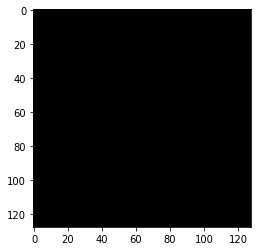

In [ ]:
generator = build_generator(SEED_SIZE, IMAGE_CHANNELS)
generator.summary()

noise = tf.random.normal([1, SEED_SIZE])
generated_image = generator(noise, training=False)

#generated_image = normalize_to_rgb(generated_image)

plt.imshow(generated_image[0,:,:,:])

In [ ]:
normalize_to_rgb(generated_image)

In [ ]:
generated_image

In [ ]:
image_shape = (GENERATE_SQUARE,GENERATE_SQUARE,IMAGE_CHANNELS)

discriminator = build_discriminator(image_shape)
decision = discriminator(generated_image)
print (decision)

tf.Tensor([[0.49999058]], shape=(1, 1), dtype=float32)


In [ ]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [ ]:
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

In [ ]:
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

In [ ]:
generator_optimizer = tf.keras.optimizers.Adam(1.5e-4,0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(1.5e-4,0.5)

In [ ]:
# Notice the use of `tf.function`
# This annotation causes the function to be "compiled".
'''
@tf.function
def train_step(images):
  seed = tf.random.normal([BATCH_SIZE, SEED_SIZE])

  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    generated_images = generator(seed, training=True)

    real_output = discriminator(images, training=True)
    fake_output = discriminator(generated_images, training=True)

    gen_loss = generator_loss(fake_output)
    disc_loss = discriminator_loss(real_output, fake_output)
    

    gradients_of_generator = gen_tape.gradient(\
        gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(\
        disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(
        gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(
        gradients_of_discriminator, 
        discriminator.trainable_variables))
  return gen_loss,disc_loss
  '''

In [ ]:
# Notice the use of `tf.function`
# This annotation causes the function to be "compiled".
@tf.function
def train_step(real_images):
  seed = tf.random.normal([BATCH_SIZE, SEED_SIZE])
  real_images = tf.cast(real_images, dtype = tf.float32)
  generated_images = generator(seed, training=True)
  # Combine them with real images
  combined_images = tf.concat([generated_images, real_images], axis=0)

  # Assemble labels discriminating real from fake images
  labels = tf.concat(
      [tf.ones((BATCH_SIZE, 1)), tf.zeros((real_images.shape[0], 1))], axis=0
  )
  # Add random noise to the labels - important trick!
  labels += 0.05 * tf.random.uniform(labels.shape)


  # Train the discriminator
  with tf.GradientTape() as tape:
      predictions = discriminator(combined_images)
      d_loss = cross_entropy(labels, predictions)
  grads = tape.gradient(d_loss, discriminator.trainable_weights)
  discriminator_optimizer.apply_gradients(zip(grads, discriminator.trainable_weights))

  # Sample random points in the latent space
  random_latent_vectors = tf.random.normal(shape=(BATCH_SIZE, SEED_SIZE))
  # Assemble labels that say "all real images"
  misleading_labels = tf.zeros((BATCH_SIZE, 1))

  # Train the generator (note that we should *not* update the weights
  # of the discriminator)!
  with tf.GradientTape() as tape:
      predictions = discriminator(generator(random_latent_vectors))
      g_loss = cross_entropy(misleading_labels, predictions)
  grads = tape.gradient(g_loss, generator.trainable_weights)
  generator_optimizer.apply_gradients(zip(grads, generator.trainable_weights))


  return g_loss,d_loss


In [ ]:
def hms_string(sec_elapsed):
  h = int(sec_elapsed / (60 * 60))
  m = int((sec_elapsed % (60 * 60)) / 60)
  s = sec_elapsed % 60
  return "{}:{:>02}:{:>05.2f}".format(h, m, s)

In [ ]:

def generate_and_save_images(model, epoch, test_input):
  # Notice `training` is set to False.
  # This is so all layers run in inference mode (batchnorm).
  # 1 - Generate images
  predictions = model(test_input, training=False)
  # 2 - Plot the generated images
  fig = plt.figure(figsize=(10,10))
  for i in range(predictions.shape[0]):
      plt.subplot(10, 10, i+1)
      plt.imshow(predictions[i, :, :, :] * 127.5 + 127.5)
      plt.axis('off')
  # 3 - Save the generated images
  plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
  plt.show()


In [ ]:
from IPython import display # A command shell for interactive computing in Python.
def train(dataset, epochs):
  fixed_seed = np.random.normal(0, 1, (PREVIEW_ROWS * PREVIEW_COLS, 
                                       SEED_SIZE))
  start = time.time()

  for epoch in range(epochs):
    epoch_start = time.time()

    gen_loss_list = []
    disc_loss_list = []

    for image_batch in dataset:
      t = train_step(image_batch)
      gen_loss_list.append(t[0])
      disc_loss_list.append(t[1])

    g_loss = sum(gen_loss_list) / len(gen_loss_list)
    d_loss = sum(disc_loss_list) / len(disc_loss_list)

        # 2 - Produce images for the GIF as we go
    display.clear_output(wait=True)
    generate_and_save_images(generator,
                             epoch + 1,
                             fixed_seed)

    epoch_elapsed = time.time()-epoch_start
    print (f'Epoch {epoch+1}, gen loss={g_loss},disc loss={d_loss},'\
           f' {hms_string(epoch_elapsed)}')
    save_images(epoch,fixed_seed)

  elapsed = time.time()-start
    # B. Generate a final image after the training is completed
  display.clear_output(wait=True)
  last_prediction = generate_and_save_images(generator,
                           epochs,
                           fixed_seed)
  return last_prediction

In [ ]:
'''
def generate_and_save_images(model, epoch, test_input):
  # Notice `training` is set to False.
  # This is so all layers run in inference mode (batchnorm).
  # 1 - Generate images
  predictions = model(test_input, training=False)
  # 2 - Plot the generated images
  fig = plt.figure(figsize=(10,10))
  for i in range(predictions.shape[0]):
      plt.subplot(10, 10, i+1)
      plt.imshow(predictions[i, :, :, :] * 127.5 + 127.5)
      plt.axis('off')
  # 3 - Save the generated images
  #plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
  plt.show()
  return predictions 
  '''

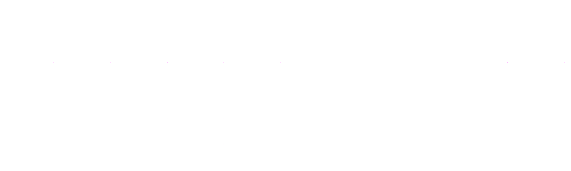

Epoch 8, gen loss=12489170.0,disc loss=15165188.0, 0:02:13.79
guardando


KeyboardInterrupt: ignored

In [ ]:
predictions = train(training_data, EPOCHS)

In [ ]:
print(predictions)

tf.Tensor(
[[[[ 0.98837185 -0.8217124   0.97786826]
   [-0.9183963   0.18940303  0.8792874 ]
   [ 0.92519826 -0.57790446  0.9823084 ]
   ...
   [ 0.99809104 -0.8899577   0.17445722]
   [ 0.9756018   0.99998504  0.99809676]
   [ 0.24594496  0.9885096  -0.9958224 ]]

  [[ 0.99990463  0.2073047   0.9799575 ]
   [-0.29987973  0.9878592   0.96777976]
   [ 0.9999756   0.8110709   0.99265426]
   ...
   [-0.9879832   0.9996387  -0.9946362 ]
   [-0.9713703   0.99999946  0.9999899 ]
   [-0.9999976   0.9988354  -0.9951021 ]]

  [[ 0.99996674 -0.19559889  0.9371419 ]
   [ 0.89629805  0.9199145   0.9844448 ]
   [ 0.9999995  -0.87006754  0.9873211 ]
   ...
   [-0.991787    0.07698419 -0.9999988 ]
   [ 0.97139245  0.6284293  -0.9982805 ]
   [-0.9635802   0.9944549  -1.        ]]

  ...

  [[ 0.9991964  -0.89772636  0.7953422 ]
   [ 0.7211295   0.99999946  0.98918694]
   [ 0.9999994   0.9976341   0.9377746 ]
   ...
   [ 0.9999876   0.9999709   0.99988896]
   [ 0.9999356   0.99694496  0.9999816 ]
   [ 

In [ ]:
import glob # The glob module is used for Unix style pathname pattern expansion.
import imageio # The library that provides an easy interface to read and write a wide range of image data

anim_file = 'dcgan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  # image = imageio.imread(filename)
  # writer.append_data(image)
  
display.Image(open('dcgan.gif','rb').read())

In [ ]:
generator.save(os.path.join(DATA_PATH,"face_generator.h5"))

NameError: ignored

## Evaluación FID 

In [ ]:
from tensorflow.keras.applications.inception_v3 import InceptionV3
# load inception v3 model
model = InceptionV3()

In [ ]:
# prepare the inception v3 model
model = InceptionV3(include_top=False, pooling='avg', input_shape=(299,299,3))

In [ ]:

# scale an array of images to a new size
def scale_images(images, new_shape):
	images_list = list()
	for image in images:
		# resize with nearest neighbor interpolation
		new_image = resize(image, new_shape, 0)
		# store
		images_list.append(new_image)
	return asarray(images_list)

In [ ]:
!sudo pip install scikit-image

In [ ]:

# calculate frechet inception distance
def calculate_fid(model, images1, images2):
	# calculate activations
	act1 = model.predict(images1)
	act2 = model.predict(images2)
	# calculate mean and covariance statistics
	mu1, sigma1 = act1.mean(axis=0), cov(act1, rowvar=False)
	mu2, sigma2 = act2.mean(axis=0), cov(act2, rowvar=False)
	# calculate sum squared difference between means
	ssdiff = numpy.sum((mu1 - mu2)**2.0)
	# calculate sqrt of product between cov
	covmean = sqrtm(sigma1.dot(sigma2))
	# check and correct imaginary numbers from sqrt
	if iscomplexobj(covmean):
		covmean = covmean.real
	# calculate score
	fid = ssdiff + trace(sigma1 + sigma2 - 2.0 * covmean)
	return fid

In [ ]:
import numpy
from numpy import cov
from numpy import trace
from numpy import iscomplexobj
from numpy import asarray
from numpy.random import randint
from scipy.linalg import sqrtm
from keras.applications.inception_v3 import InceptionV3
from keras.applications.inception_v3 import preprocess_input
from keras.datasets.mnist import load_data
from skimage.transform import resize

In [ ]:
from tensorflow.python.ops.numpy_ops import np_config
np_config.enable_numpy_behavior()

In [ ]:
# convert integer to floating point values
images1 = train_images.astype('float32')
images2 = predictions.astype('float32')
# resize images
images1 = scale_images(images1, (299,299,3))
images2 = scale_images(images2, (299,299,3))
print('Scaled', images1.shape, images2.shape)
# pre-process images
images1 = preprocess_input(images1)
images2 = preprocess_input(images2)
# fid between images1 and images1
fid = calculate_fid(model, images1, images1)
print('FID (same): %.3f' % fid)
# fid between images1 and images2
fid = calculate_fid(model, images1, images2)
print('FID (different): %.3f' % fid)

In [ ]:
train_images.shape

(100, 128, 128, 3)

## GAN Tunning

In [ ]:
!pip install keras_tuner

In [ ]:
# load image and convert to and from NumPy array
from PIL import Image
from numpy import asarray
from skimage import transform, data, io
import cv2
# load the image
def img_to_array(path):

  img = cv2.imread(path, 1) #change 1 to 0 for gray images

  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  img = cv2.resize(img, (128,128))
  # convert image to numpy array
  #image = image.convert('RGB')
  data = asarray(img)
  #data = tf.convert_to_tensor(data)
  # summarize shape
  return data

In [ ]:

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import keras_tuner as kt
import numpy as np

class GAN(keras.Model):
    def __init__(self, discriminator, generator, latent_dim):
        super(GAN, self).__init__()
        self.discriminator = discriminator
        self.generator = generator
        self.latent_dim = latent_dim
        self.gen_loss_tracker = keras.metrics.Mean(name="generator_loss")
        self.disc_loss_tracker = keras.metrics.Mean(name="discriminator_loss")

    @property
    def metrics(self):
        return [self.gen_loss_tracker, self.disc_loss_tracker]

    def compile(self, d_optimizer, g_optimizer, loss_fn):
        super(GAN, self).compile()
        self.d_optimizer = d_optimizer
        self.g_optimizer = g_optimizer
        self.loss_fn = loss_fn #esta es una crossentropy

    def train_step(self, real_images):

      batch_size = tf.shape(real_images)[0]

      # Sample random points in the latent space
      random_latent_vectors = tf.random.normal(shape=(batch_size, self.latent_dim))
      # Decode them to fake images
      generated_images = self.generator(random_latent_vectors)
      # Combine them with real images
      combined_images = tf.concat([generated_images, real_images], axis=0)

      # Assemble labels discriminating real from fake images
      labels = tf.concat(
          [tf.ones((batch_size, 1)), tf.zeros((real_images.shape[0], 1))], axis=0
      )
      # Add random noise to the labels - important trick!
      labels += 0.05 * tf.random.uniform(labels.shape)

      # Train the discriminator
      with tf.GradientTape() as tape:
          predictions = self.discriminator(combined_images)
          d_loss = self.loss_fn(labels, predictions)
      grads = tape.gradient(d_loss, self.discriminator.trainable_weights)
      self.d_optimizer.apply_gradients(zip(grads, self.discriminator.trainable_weights))

      # Sample random points in the latent space
      random_latent_vectors = tf.random.normal(shape=(batch_size, self.latent_dim))
      # Assemble labels that say "all real images"
      misleading_labels = tf.zeros((batch_size, 1))

      # Train the generator (note that we should *not* update the weights
      # of the discriminator)!
      with tf.GradientTape() as tape:
          predictions = self.discriminator(self.generator(random_latent_vectors))
          g_loss = self.loss_fn(misleading_labels, predictions)
      grads = tape.gradient(g_loss, self.generator.trainable_weights)
      self.g_optimizer.apply_gradients(zip(grads, self.generator.trainable_weights))

      # Monitor loss.
      self.gen_loss_tracker.update_state(g_loss)
      self.disc_loss_tracker.update_state(d_loss)

      return {
            "g_loss": self.gen_loss_tracker.result(),
            "d_loss": self.disc_loss_tracker.result(),
        }

In [ ]:
## Generar y

labels = []

for id, f in enumerate(files_list):
  labels.append(f.split("/")[-2])
  #print(f.split("/")[-2])


In [ ]:
from sklearn import preprocessing
encoder = preprocessing.LabelEncoder()
encoder.fit(labels)

print(len(encoder.classes_))

y = encoder.transform(labels)

#encoder.inverse_transform([0, 0, 1, 2])

NameError: ignored

In [ ]:
len(y)

In [ ]:
from sklearn.model_selection import train_test_split
# Model / data parameters
num_classes = 15
input_shape = (128, 128, 3)

# the data, split between train and test sets
#(x_train, y_train), (x_test, y_test) = tf.keras.datasets.mnist.load_data()

#alternativa
images = np.zeros((6000, 128,128,3))
for index, file in enumerate(files_list):
  image = img_to_array(file)
  images[index] = image


x_train, x_test, y_train, y_test = train_test_split(images, y, test_size=0.20, random_state=42)

#We will use a TensorFlow Dataset object to actually hold the images. 
#This allows the data to be quickly shuffled int divided into the appropriate batch sizes for training

#training_data= tf.data.Dataset.from_tensor_slices(train_images).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

#Generar split 80, 20

# Scale images to the [0, 1] range
x_train = x_train.astype("float32") / 255
x_test = x_test.astype("float32") / 255
# Make sure images have shape (28, 28, 1)
#x_train = np.expand_dims(x_train, -1)
#x_test = np.expand_dims(x_test, -1)
print("x_train shape:", x_train.shape)
print(x_train.shape[0], "train samples")
print(x_test.shape[0], "test samples")


# convert class vectors to binary class matrices
#y_train = tf.keras.utils.to_categorical(y_train, num_classes)
#y_test = tf.keras.utils.to_categorical(y_test, num_classes)

model = keras.Sequential(
    [
        keras.Input(shape=input_shape),
        layers.Conv2D(32, kernel_size=(3, 3), activation="relu"),
        layers.MaxPooling2D(pool_size=(2, 2)),
        layers.Conv2D(64, kernel_size=(3, 3), activation="relu"),
        layers.MaxPooling2D(pool_size=(2, 2)),
        layers.Flatten(),
        layers.Dropout(0.5),
        layers.Dense(num_classes, activation="softmax"),
    ]
)

batch_size = 128
epochs = 15

model.compile(loss = 'sparse_categorical_crossentropy', optimizer="adam", metrics=["accuracy"])
model.fit(x_train, y_train, batch_size=batch_size, epochs=epochs, validation_split=0.1)

In [ ]:

from numpy import log, mean, std, floor, exp, expand_dims

# assumes images have the shape 299x299x3, pixels in [0,255]
def calculate_score(images, class_model, n_split=10, eps=10**-16):
  # load classification model
  model = class_model
  # convert from uint8 to float32
  print(type(images))
  processed = images.astype("float32")
  # pre-process raw images for inception v3 model
  # Scale images to the [0, 1] range
  images = images.astype("float32") / 255
  # Make sure images have shape (28, 28, 1)
  images = np.expand_dims(images, -1)
  # predict class probabilities for images
  yhat = model.predict(processed)
  # enumerate splits of images/predictions
  scores = list()
  n_part = floor(images.shape[0] / n_split)

  for i in range(n_split):
    # retrieve p(y|x)
    ix_start, ix_end = int(i * n_part), int(i * n_part + n_part)
    p_yx = yhat[ix_start:ix_end]
    # calculate p(y)
    p_y = expand_dims(p_yx.mean(axis=0), 0)
    # calculate KL divergence using log probabilities
    kl_d = p_yx * (log(p_yx + eps) - log(p_y + eps))
    # sum over classes
    sum_kl_d = kl_d.sum(axis=1)
    # average over images
    avg_kl_d = mean(sum_kl_d)
    # undo the log
    is_score = exp(avg_kl_d)
    # store
    scores.append(is_score)

  # average across images
  is_avg, is_std = mean(scores), std(scores)

  return is_avg, is_std

In [ ]:
def make_discriminator_model(self, hp_drop_rate):
    model = tf.keras.Sequential()
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same',
                                    input_shape=[128,128, 3]))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(hp_drop_rate))

    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(hp_drop_rate))

    model.add(layers.Flatten())
    model.add(layers.Dense(1))

    return model

    # Build generator
def make_generator_model(self, latent_dim, batch_norm, activation_function):
    model = tf.keras.Sequential()
    model.add(layers.Dense(32*32*256, use_bias=False, input_shape=[latent_dim]))
    if batch_norm == True:
      model.add(layers.BatchNormalization())
    model.add(activation_function)
    model.add(layers.Reshape((32, 32, 256)))
    assert model.output_shape == (None, 32, 32, 256) #None corresponds to the batch size
    
    model.add(layers.Conv2DTranspose(128, (5, 5), strides=(1, 1), padding='same'))
    assert model.output_shape == (None, 32, 32, 128)
    if batch_norm == True:
      model.add(layers.BatchNormalization())
    
    model.add(activation_function)
    
    model.add(layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same'))
    assert model.output_shape == (None, 64, 64, 64)
    if batch_norm == True:
      model.add(layers.BatchNormalization())
    
    model.add(activation_function)
    
    model.add(layers.Conv2DTranspose(3, (5, 5), strides=(2, 2), padding='same',  activation='tanh'))
    assert model.output_shape == (None, 128, 128, 3)

    return model 

    
def build(self, hp):
   
    hp_drop_rate = hp.Float('dropout rate', min_value = 0, max_value = 0.9)
    batch_norm = hp.Boolean('batch normalization')
    activation_function = hp.Choice('activation function', ['relu', 'leaky_relu'])
    latent_dim = 100

    
    activation_dict = {
        'leaky_relu': layers.LeakyReLU(), 
        'relu': layers.ReLU()
    }

    self.discriminator = self.make_discriminator_model(hp_drop_rate)
    self.generator = self.make_generator_model(hp_latent_dim, batch_norm, activation_dict[activation_function])


    model_gan = GAN(self.discriminator, self.generator, hp_latent_dim)
    
    adam_optimizer = tf.keras.optimizers.Adam(1e-4)
    binary_crossentropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)
    model_gan.compile(adam_optimizer,adam_optimizer,binary_crossentropy)
    
    return model_gan

In [ ]:
class HyperGAN(kt.HyperModel):

  def __init__(self, class_model):
        super(HyperGAN, self).__init__()
        self.class_model = class_model

      # Build discriminator function
  def make_discriminator_model(self, hp_drop_rate):
    model = tf.keras.Sequential()
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same',
                                    input_shape=[128,128, 3]))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(hp_drop_rate))

    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(hp_drop_rate))

    model.add(layers.Flatten())
    model.add(layers.Dense(1))

    return model

  def make_generator_model(self, latent_dim, batch_norm, activation_function):
      model = tf.keras.Sequential()
      model.add(layers.Dense(32*32*256, use_bias=False, input_shape=[latent_dim]))
      if batch_norm == True:
        model.add(layers.BatchNormalization())
      model.add(activation_function)
      model.add(layers.Reshape((32, 32, 256)))
      assert model.output_shape == (None, 32, 32, 256) #None corresponds to the batch size
      
      model.add(layers.Conv2DTranspose(128, (5, 5), strides=(1, 1), padding='same'))
      assert model.output_shape == (None, 32, 32, 128)
      if batch_norm == True:
        model.add(layers.BatchNormalization())
      
      model.add(activation_function)
      
      model.add(layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same'))
      assert model.output_shape == (None, 64, 64, 64)
      if batch_norm == True:
        model.add(layers.BatchNormalization())
      
      model.add(activation_function)
      
      model.add(layers.Conv2DTranspose(3, (5, 5), strides=(2, 2), padding='same',  activation='tanh'))
      assert model.output_shape == (None, 128, 128, 3)

      return model 

    
  def build(self, hp):

      #hp_latent_dim = hp.Int('latent_dim', min_value = 10, max_value = 500, step = 32)
      hp_drop_rate = hp.Float('dropout rate', min_value = 0, max_value = 0.9)
      batch_norm = hp.Boolean('batch normalization')
      activation_function = hp.Choice('activation function', ['relu', 'leaky_relu'])
      hp_latent_dim = 100

      
      activation_dict = {
          'leaky_relu': layers.LeakyReLU(), 
          'relu': layers.ReLU()
      }

      self.discriminator = self.make_discriminator_model(hp_drop_rate)
      self.generator = self.make_generator_model(hp_latent_dim, batch_norm, activation_dict[activation_function])


      model_gan = GAN(self.discriminator, self.generator, hp_latent_dim)
      
      adam_optimizer = tf.keras.optimizers.Adam(1e-4)
      binary_crossentropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)
      model_gan.compile(adam_optimizer,adam_optimizer,binary_crossentropy)
      return model_gan
      
    
    # assumes images have the shape 299x299x3, pixels in [0,255]
  def calculate_score(self, images, n_split=10, eps=10**-16):
      # load classification model
      model = self.class_model
      # convert from uint8 to float32
      processed = images.astype("float32")
      # pre-process raw images for inception v3 model
      # Scale images to the [0, 1] range
      images = images.astype("float32") / 255
      # Make sure images have shape (28, 28, 1)
      images = np.expand_dims(images, -1)
      # predict class probabilities for images
      yhat = model.predict(processed)
      # enumerate splits of images/predictions
      scores = list()
      n_part = floor(images.shape[0] / n_split)

      for i in range(n_split):
        # retrieve p(y|x)
        ix_start, ix_end = int(i * n_part), int(i * n_part + n_part)
        p_yx = yhat[ix_start:ix_end]
        # calculate p(y)
        p_y = expand_dims(p_yx.mean(axis=0), 0)
        # calculate KL divergence using log probabilities
        kl_d = p_yx * (log(p_yx + eps) - log(p_y + eps))
        # sum over classes
        sum_kl_d = kl_d.sum(axis=1)
        # average over images
        avg_kl_d = mean(sum_kl_d)
        # undo the log
        is_score = exp(avg_kl_d)
        # store
        scores.append(is_score)

      # average across images
      is_avg, is_std = mean(scores), std(scores)

      return is_avg, is_std

  def fit(self, hp, model, x, **kwargs):
        model.fit(x,**kwargs)
        # Sample random points in the latent space
        random_latent_vectors = tf.random.normal(shape=(500, model.latent_dim))
        # Decode them to fake images
        generated_images = model.generator.predict(random_latent_vectors)
        
        mean_score, std_score = self.calculate_score(generated_images)
        # Return a single float to minimize.
        return -mean_score

In [ ]:
trials = 10

tuner = kt.BayesianOptimization(
    hypermodel=HyperGAN(model),
    # No objective to specify.
    # Objective is the return value of `HyperModel.fit()`.
    max_trials=trials,
    overwrite=True,
    directory="my_dir",
    project_name="custom_eval",
)

tuner.search(
    x = x_train, epochs = 10
    )

tuner.results_summary()


Search: Running Trial #1

Value             |Best Value So Far |Hyperparameter
0.70065           |?                 |dropout rate
False             |?                 |batch normalization
relu              |?                 |activation function

Epoch 1/10


ValueError: ignored

<Figure size 800x480 with 0 Axes>

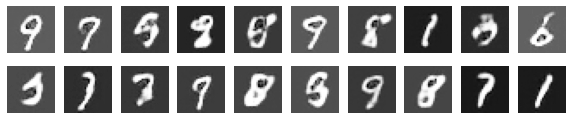

In [ ]:
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure

# function to plot the images
def plot_multiple_images(images, n_cols=None):
    n_cols = n_cols or len(images)
    n_rows = (len(images) - 1) // n_cols + 1
    if images.shape[-1] == 1:
        images = np.squeeze(images, axis=-1)
    plt.figure(figsize=(n_cols, n_rows))
    for index, image in enumerate(images):
        plt.subplot(n_rows, n_cols, index + 1)
        plt.imshow(image*127.5+127.5, cmap="gray")
        #plt.savefig('/content/sample_data/binary_alpha_digits/image_at_epoch_{:04d}.png'.format(epochs))
        plt.axis("off")

best_model = tuner.get_best_models()[0]

random_latent_vectors = tf.random.normal(shape=(20, best_model.latent_dim))

generated_images = best_model.generator.predict(random_latent_vectors)
figure(figsize = (10, 6), dpi = 80)
plot_multiple_images(generated_images, 10) 
plt.show()

## Torch DCGAN implementation

In [ ]:
print(len(os.listdir(dataroot+'knn')))

800


In [ ]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [ ]:
# Root directory for dataset
dataroot = '/content/drive/Shared drives/SpotifyMemoria/MM_full/Knn/'

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 1000

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

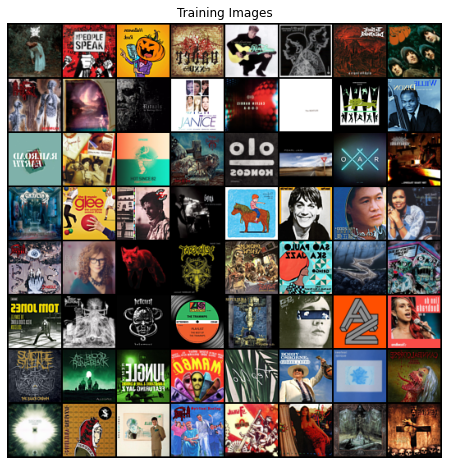

In [ ]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [ ]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [ ]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.02.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [ ]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [ ]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [ ]:
from torchsummary import summary
summary(netD, (3,128,128))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 64, 64]           3,072
         LeakyReLU-2           [-1, 64, 64, 64]               0
            Conv2d-3          [-1, 128, 32, 32]         131,072
       BatchNorm2d-4          [-1, 128, 32, 32]             256
         LeakyReLU-5          [-1, 128, 32, 32]               0
            Conv2d-6          [-1, 256, 16, 16]         524,288
       BatchNorm2d-7          [-1, 256, 16, 16]             512
         LeakyReLU-8          [-1, 256, 16, 16]               0
            Conv2d-9            [-1, 512, 8, 8]       2,097,152
      BatchNorm2d-10            [-1, 512, 8, 8]           1,024
        LeakyReLU-11            [-1, 512, 8, 8]               0
           Conv2d-12              [-1, 1, 5, 5]           8,192
          Sigmoid-13              [-1, 1, 5, 5]               0
Total params: 2,765,568
Trainable param

In [ ]:
summary(netG, (100,1,1))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ConvTranspose2d-1            [-1, 512, 4, 4]         819,200
       BatchNorm2d-2            [-1, 512, 4, 4]           1,024
              ReLU-3            [-1, 512, 4, 4]               0
   ConvTranspose2d-4            [-1, 256, 8, 8]       2,097,152
       BatchNorm2d-5            [-1, 256, 8, 8]             512
              ReLU-6            [-1, 256, 8, 8]               0
   ConvTranspose2d-7          [-1, 128, 16, 16]         524,288
       BatchNorm2d-8          [-1, 128, 16, 16]             256
              ReLU-9          [-1, 128, 16, 16]               0
  ConvTranspose2d-10           [-1, 64, 32, 32]         131,072
      BatchNorm2d-11           [-1, 64, 32, 32]             128
             ReLU-12           [-1, 64, 32, 32]               0
  ConvTranspose2d-13            [-1, 3, 64, 64]           3,072
             Tanh-14            [-1, 3,

In [ ]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/40][0/326]	Loss_D: 1.7526	Loss_G: 7.1411	D(x): 0.6935	D(G(z)): 0.6682 / 0.0014
[0/40][50/326]	Loss_D: 1.4022	Loss_G: 25.2812	D(x): 0.4984	D(G(z)): 0.0000 / 0.0000
[0/40][100/326]	Loss_D: 0.1706	Loss_G: 8.7910	D(x): 0.8824	D(G(z)): 0.0007 / 0.0008
[0/40][150/326]	Loss_D: 0.7169	Loss_G: 2.0997	D(x): 0.7384	D(G(z)): 0.2883 / 0.1434
[0/40][200/326]	Loss_D: 0.1425	Loss_G: 5.0170	D(x): 0.9165	D(G(z)): 0.0483 / 0.0087
[0/40][250/326]	Loss_D: 0.0929	Loss_G: 6.5276	D(x): 0.9496	D(G(z)): 0.0364 / 0.0024
[0/40][300/326]	Loss_D: 0.1095	Loss_G: 5.2996	D(x): 0.9603	D(G(z)): 0.0613 / 0.0064
[1/40][0/326]	Loss_D: 0.7036	Loss_G: 7.0149	D(x): 0.7733	D(G(z)): 0.1689 / 0.0046
[1/40][50/326]	Loss_D: 0.2776	Loss_G: 6.0191	D(x): 0.8809	D(G(z)): 0.0643 / 0.0031
[1/40][100/326]	Loss_D: 0.1127	Loss_G: 5.1443	D(x): 0.9264	D(G(z)): 0.0176 / 0.0139
[1/40][150/326]	Loss_D: 0.1337	Loss_G: 4.3816	D(x): 0.9656	D(G(z)): 0.0860 / 0.0216
[1/40][200/326]	Loss_D: 1.2142	Loss_G: 3.4467	D(x): 0.5

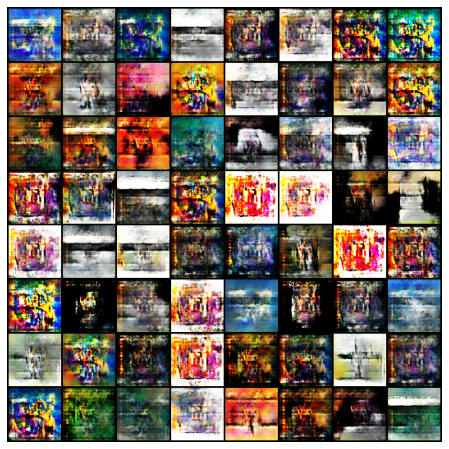

In [ ]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [ ]:
writervideo = ani.FFMpegWriter(fps=60) 
ani.save('/content/drive/Shared drives/SpotifyMemoria/MM_full/100_epoch.mp4', writer=writervideo)

## Random

In [ ]:
import pandas as pd

In [ ]:
df = pd.read_excel(

TypeError: ignored

In [ ]:
df

,id_spotify,name,artist,image_url,album,genre
0,6olaPIBVCwYF6ofjhJgSIz,ãƒ–ãƒ©ãƒƒãƒ‰ã‚µãƒ¼ã‚­ãƒ¥ãƒ¬ãƒ¼ã‚¿ãƒ¼,ASIAN KUNG FU GENERATION,https://i.scdn.co/image/ab67616d0000b273099c36...,Blood Circulator,anime
1,08oH4bSxeZ5KxZOGjJkwRK,Dororo,ASIAN KUNG FU GENERATION,https://i.scdn.co/image/ab67616d0000b2730daad5...,Dororo Liberated Zone,anime
2,3txqYlzoDZGLoW8MGll9tQ,ãƒªãƒ©ã‚¤ãƒˆ,ASIAN KUNG FU GENERATION,https://i.scdn.co/image/ab67616d0000b27342b08c...,ã‚½ãƒ«ãƒ•ã‚¡,anime
3,2QaD2jnLNJgvyjT84hODSE,ã‚¨ãƒ³ãƒ‘ã‚·ãƒ¼,ASIAN KUNG FU GENERATION,https://i.scdn.co/image/ab67616d0000b2735d333a...,ã‚¨ãƒ³ãƒ‘ã‚·ãƒ¼,anime
4,6XsJTpZwPKMcG8QK8k14Z6,ã‚¢ãƒ•ã‚¿ãƒ¼ãƒ€ãƒ¼ã‚¯,ASIAN KUNG FU GENERATION,https://i.scdn.co/image/ab67616d0000b2733bb727...,ãƒ¯ãƒ¼ãƒ«ãƒ‰ ãƒ¯ãƒ¼ãƒ«ãƒ‰ ãƒ¯ãƒ¼ãƒ«ãƒ‰,anime
5,00sHjhTQCLaGUw0OJvmpVB,ãƒªãƒ©ã‚¤ãƒˆ (2016 Version),ASIAN KUNG FU GENERATION,https://i.scdn.co/image/ab67616d0000b273fc33a1...,Sol-Fa (2016 Rerecorded Version),anime
6,3rb5K4Cw0GsLsgjcSYAP9K,ãƒªãƒ©ã‚¤ãƒˆ,ASIAN KUNG FU GENERATION,https://i.scdn.co/image/ab67616d0000b2731ad7b6...,Sol-fa,anime
7,28MKy2umF5roXSqmUQ9eB7,Re Re,ASIAN KUNG FU GENERATION,https://i.scdn.co/image/ab67616d0000b2731ad7b6...,Sol-fa,anime
8,4eSSRTR5guMgoLaB4YmFwi,Re Re (2016 Version),ASIAN KUNG FU GENERATION,https://i.scdn.co/image/ab67616d0000b273fc33a1...,Sol-Fa (2016 Rerecorded Version),anime
9,18tdT5x5BBvdyUX16xnL55,ãã‚Œã§ã¯ã€ã¾ãŸæ˜Žæ—¥,ASIAN KUNG FU GENERATION,https://i.scdn.co/image/ab67616d0000b2737536a5...,Best Hit AKG 2 (2012-2018),anime


In [ ]:
#https://gsurma.github.io
#cover art dataset 